In [ ]:
!pip install mne

## Preprocessing

In [67]:
import mne
import scipy
import imageio

import numpy as np
import pandas as pd

from typing import List
import matplotlib.pyplot as plt

from IPython.display import Image

In [4]:
def load_data(path: str) -> pd.DataFrame:
    data = pd.read_csv(path, header=None)
    data = data.T

    return data

In [5]:
first = load_data("https://raw.githubusercontent.com/aalexren/iu-dsp/master/hw03/first.csv")
first[:3]

,0,1,2,3,4,5,6,7,8,9,...,22,23,24,25,26,27,28,29,30,31
0,-0.000007,1.361943e-05,-0.000004,-0.000002,-0.000006,-0.00001,-7.595006e-07,-0.000001,-1.664115e-06,-0.000001,...,0.000009,0.000007,8.767896e-07,0.000004,0.000009,0.000012,0.000013,0.000007,0.000013,0.000017
1,-0.000002,6.889464e-06,-0.000006,-0.000005,-0.000008,-0.00001,-2.828937e-06,-0.000002,-1.277049e-06,-0.000003,...,0.000008,0.000006,2.154500e-06,0.000004,0.000009,0.000011,0.000011,0.000009,0.000014,0.000015
2,0.000003,9.700098e-08,-0.000008,-0.000009,-0.000010,-0.00001,-4.739417e-06,-0.000002,-8.981117e-07,-0.000004,...,0.000008,0.000006,3.621418e-06,0.000005,0.000009,0.000011,0.000009,0.000011,0.000014,0.000013


In [6]:
def pddf_to_mne(data: pd.DataFrame) -> mne.io.RawArray:
    # https://mne.tools/0.15/generated/mne.channels.read_montage.html
    montage = mne.channels.make_standard_montage("biosemi32")
    channels = list(montage.get_positions()['ch_pos'].keys())

    raw_array = mne.io.RawArray(
        data.T, mne.create_info(channels, 1000, ch_types='eeg')
    )
    raw_array._data = mne.baseline.rescale(
        raw_array._data, times=raw_array.times, baseline=(None, 5)
    )

    raw_array.set_montage(montage)


    return raw_array

In [7]:
first_mne = pddf_to_mne(first)
first_mne

Creating RawArray with float64 data, n_channels=32, n_times=10012
    Range : 0 ... 10011 =      0.000 ...    10.011 secs
Ready.
Applying baseline correction (mode: mean)


<RawArray | 32 x 10012 (10.0 s), ~2.5 MB, data loaded>

In [128]:
def plot_mne(data: mne.io.RawArray):
    data_psd = data.compute_psd()

    data.plot_sensors(show_names=True)
    data_psd.plot_topomap()
    data_psd.plot()
    data.plot()

Effective window size : 0.256 (s)


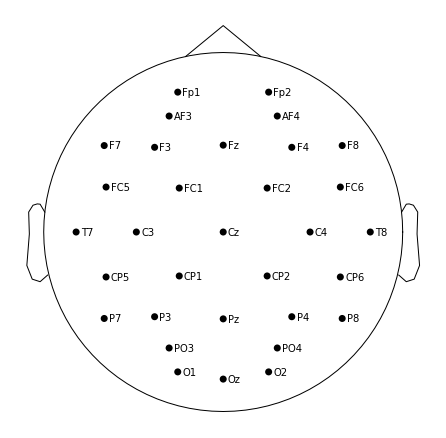

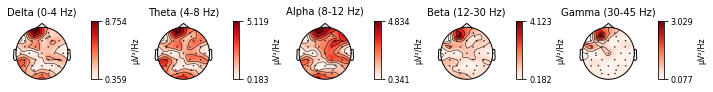

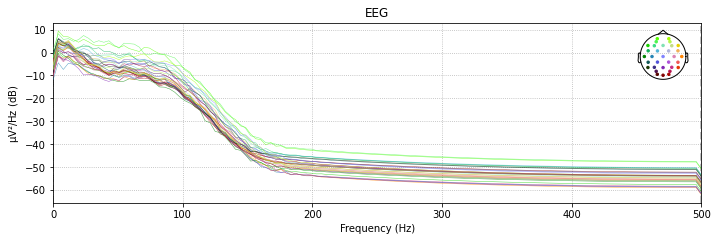

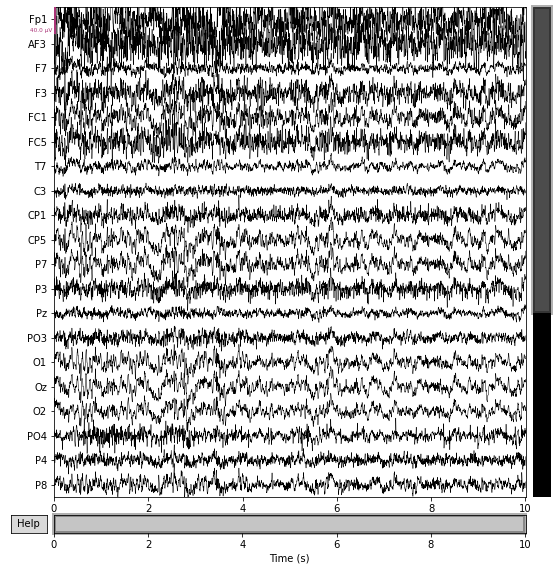

In [129]:
plot_mne(first_mne)

## Explore topomaps activities

In [111]:
def topomap_motion(data: mne.io.RawArray, start: float, stop: float, wsize: float=0.256, name="exmaple.gif"):
    time = start
    index = [0]
    while time + 1 <= stop:
        temp = data.copy()
        temp.crop(tmin=time, tmax=time+wsize)
        psd = temp.compute_psd()
        fig = psd.plot_topomap(show_names=True, show=False)
        fig.set_size_inches(18.5, 10.5)
        plt.savefig(f"img_{index[-1]}.png", transparent = False, facecolor = 'white')
        plt.show()
        time += wsize/2
        index.append(index[-1] + 1)

    index = index[:-1]
    frames = []
    for t in index:
        image = imageio.imread(f'img_{t}.png')
        frames.append(image)
    imageio.mimsave(f'{name}', 
                frames, 
                fps=2, 
                loop=0)

Effective window size : 0.256 (s)


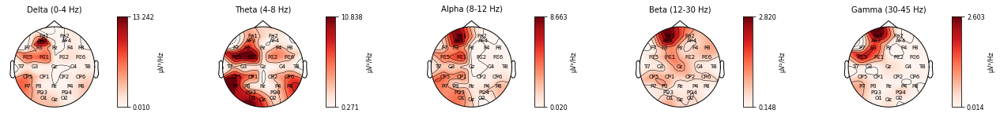

Effective window size : 0.256 (s)


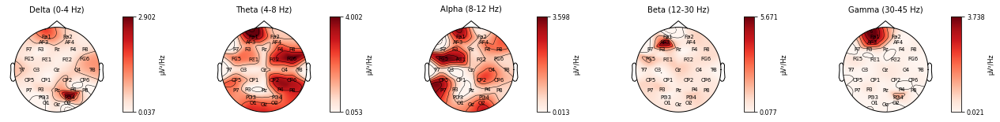

Effective window size : 0.256 (s)


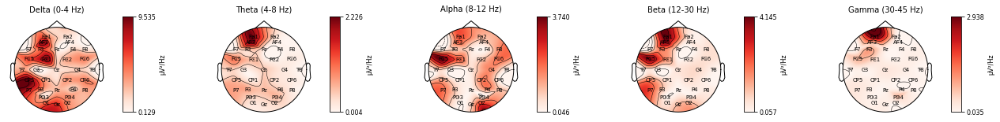

Effective window size : 0.256 (s)


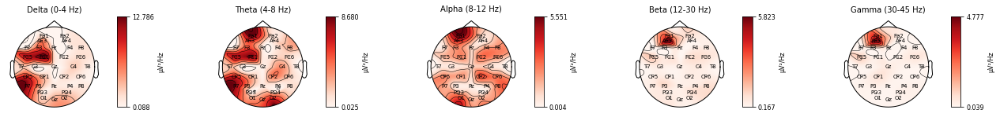

Effective window size : 0.256 (s)


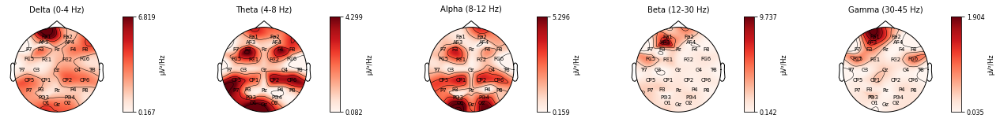

Effective window size : 0.256 (s)


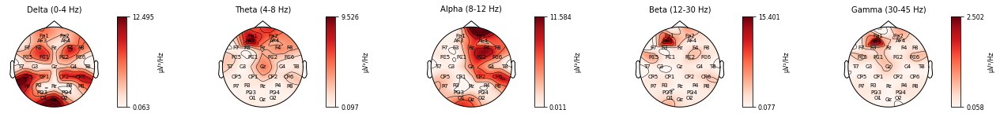

Effective window size : 0.256 (s)


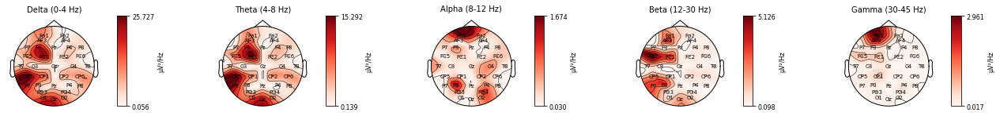

Effective window size : 0.256 (s)


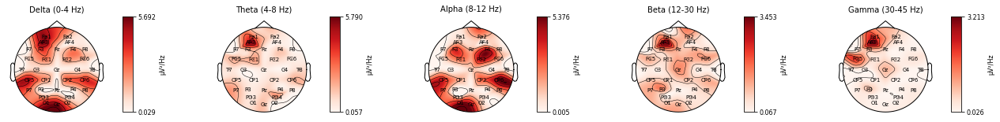

Effective window size : 0.256 (s)


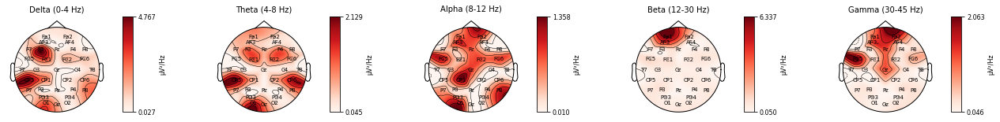

Effective window size : 0.256 (s)


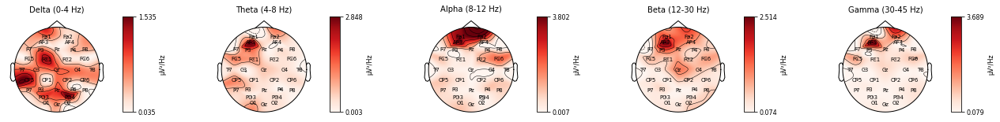

Effective window size : 0.256 (s)


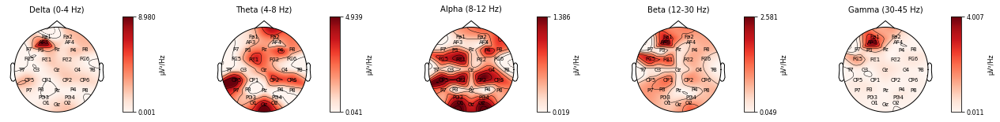

Effective window size : 0.256 (s)


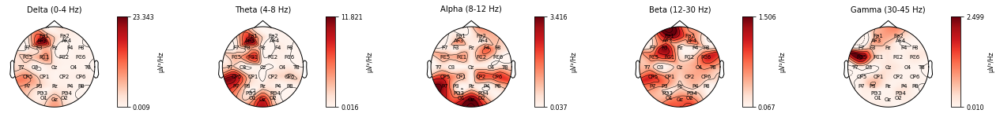

Effective window size : 0.256 (s)


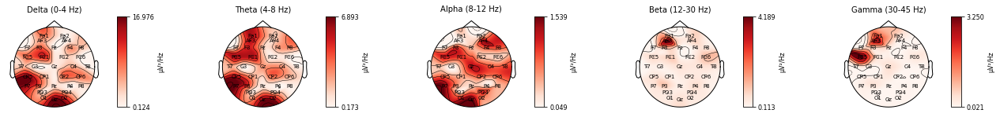

Effective window size : 0.256 (s)


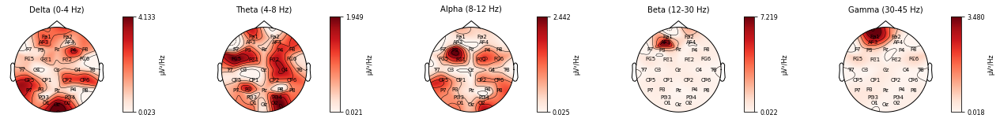

Effective window size : 0.256 (s)


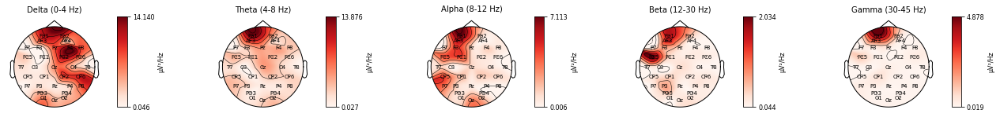

Effective window size : 0.256 (s)


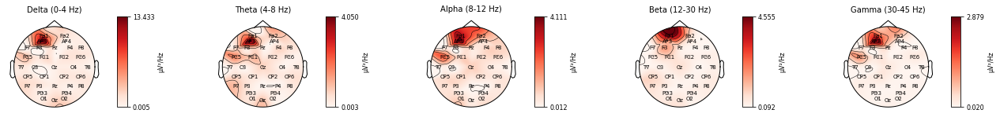

Effective window size : 0.256 (s)


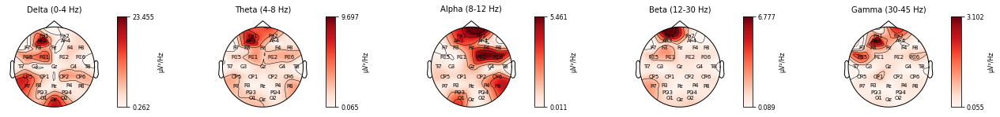

Effective window size : 0.256 (s)


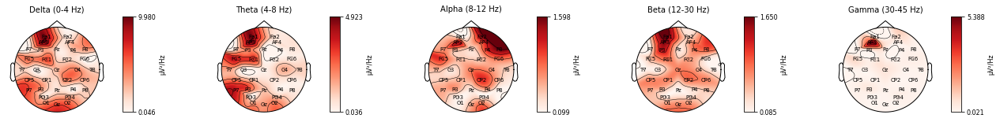

Effective window size : 0.256 (s)


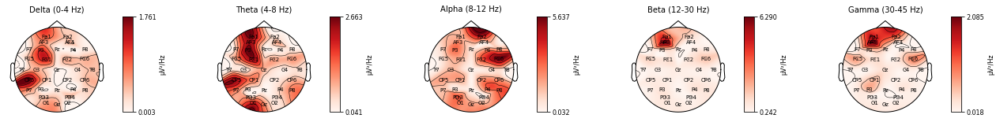

Effective window size : 0.256 (s)


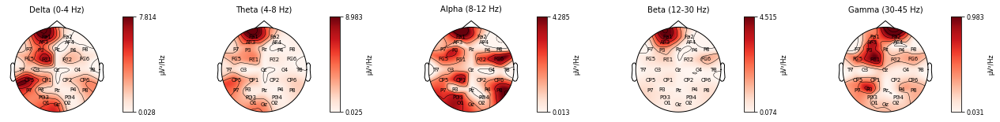

Effective window size : 0.256 (s)


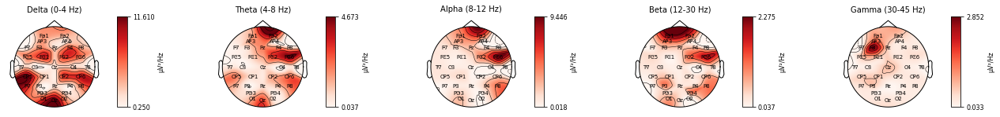

Effective window size : 0.256 (s)


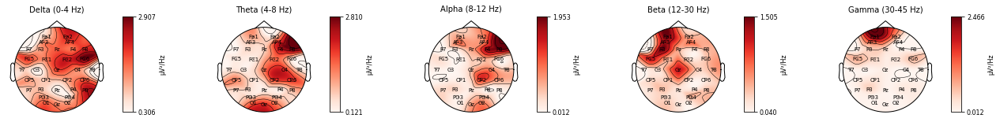

Effective window size : 0.256 (s)


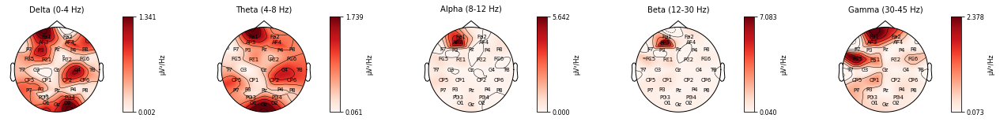

Effective window size : 0.256 (s)


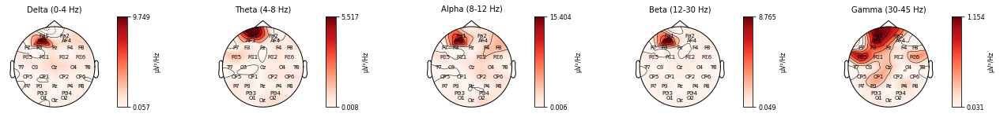

Effective window size : 0.256 (s)


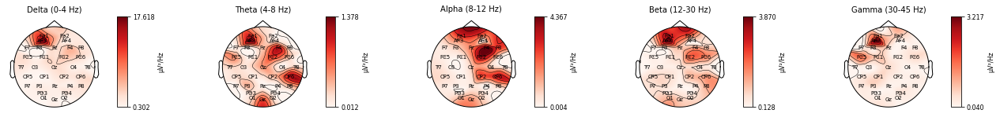

Effective window size : 0.256 (s)


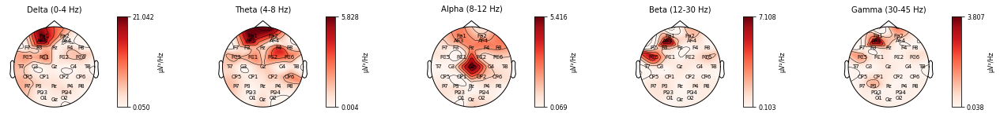

Effective window size : 0.256 (s)


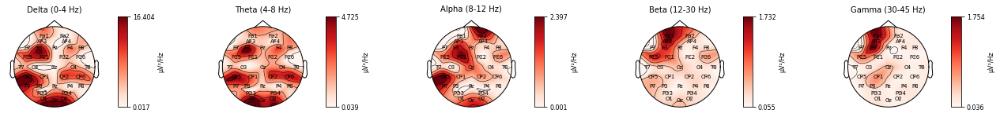

Effective window size : 0.256 (s)


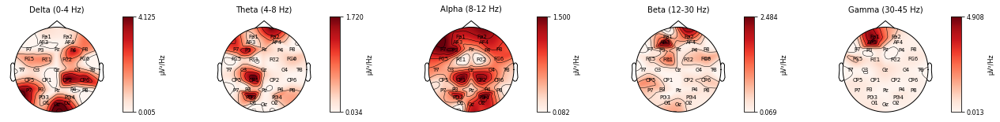

Effective window size : 0.256 (s)


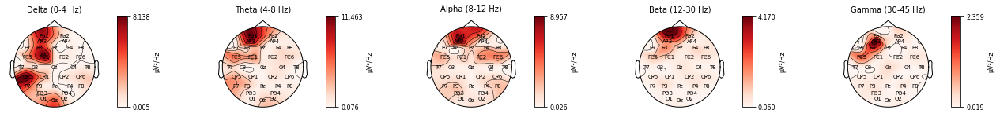

Effective window size : 0.256 (s)


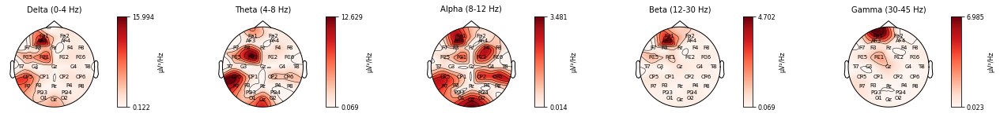

Effective window size : 0.256 (s)


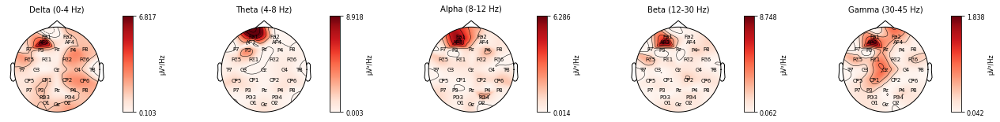

Effective window size : 0.256 (s)


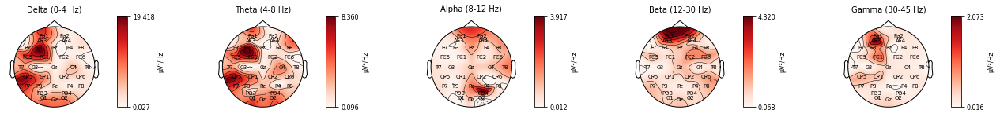

In [112]:
topomap_motion(first_mne, 5., 10., name="first.gif")

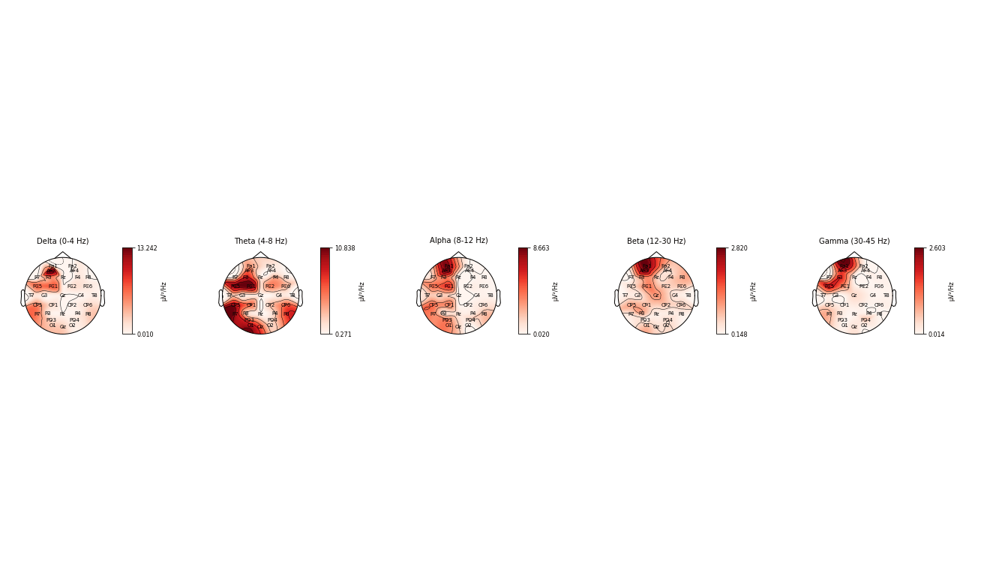

In [113]:
Image(open('first.gif','rb').read())

## Exclude redundant channels

In [9]:
'''Human brain oscillators'''
HBO = {
    "delta": (0, 4),
    "theta": (4, 8),
    "alpha": (8, 12),
    "beta": (12, 30),
    "gamma": (30, 45)
}

In [10]:
"""
Unfortunately, this isn't helpful, because overall variance 
couldn't be representative for such kind of research. 
It demands on different solution with extracting channels.
"""
def select_k_best(data: mne.io.RawArray, k: int=2) -> List[str]:
    '''
    Selection based on variance.

    WARNING! Computing depends on Python and Numpy versions.

    https://asp-eurasipjournals.springeropen.com/articles/10.1186/s13634-015-0251-9
    '''
    ch_datas = data._data
    ch_names = np.array(data.ch_names)

    means = [0] * len(ch_datas)
    for _, (lf, rf) in HBO.items():
        ch_filtered = [
            scipy.signal.sosfilt(
                scipy.signal.butter(
                    lf, rf, 'hp', output='sos', fs=data.info['sfreq']
            ), ch)
        for ch in ch_datas]

        ch_vars = [np.var(ch) for ch in ch_filtered] # variances
        for idx, ch in enumerate(ch_vars):
            means[idx] += ch_vars[idx]
        
    for i in range(len(means)):
        means[i] /= float(len(HBO))

    sort_means, sort_names = zip(
        *sorted(zip(means, ch_names), key=lambda x: x[0], reverse=True)
    )
    fig = plt.figure(figsize=(20, 5))
    plt.bar(sort_names, sort_means, width=.8, color='g')
    plt.ylabel("Mean Variance")
    plt.xlabel("Channel names")
    plt.show()
    
    return ch_names[np.argsort(means)[-k:]].tolist()


In [11]:
# !pip freeze | grep numpy
!python --version
# !sudo update-alternatives --config python3
# !sudo update-alternatives --install /usr/bin/python3 python3 /usr/bin/python3.10 1
# !sudo apt-get install python3.10

Python 3.9.16


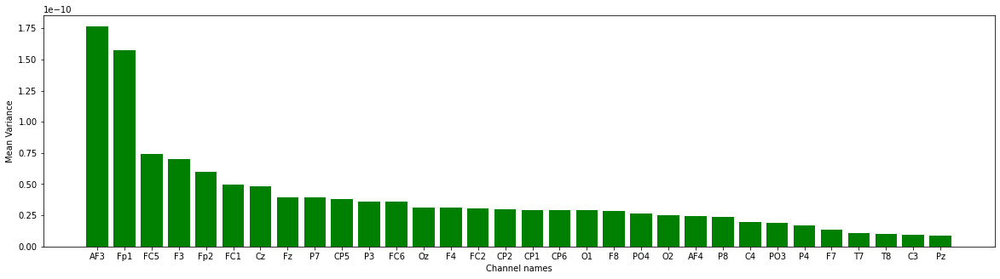

['Fp1', 'AF3']

In [12]:
# select_k_best(first_mne, 2)

## Channel selection

In [118]:
def extract_channels(data: mne.io.RawArray, channels: List[str]) -> mne.io.RawArray:
    ret = data.copy()
    ret.pick_channels(channels)
    return ret

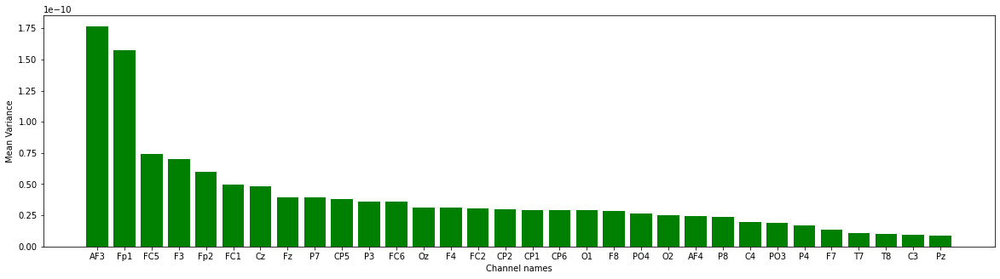

<RawArray | 2 x 10012 (10.0 s), ~178 kB, data loaded>

In [16]:
first_selected = extract_channels(first_mne, select_k_best(first_mne, 2))
first_selected

## Key frequencies range

In [121]:
"""
See the mean in PSD by all chosen channels.
"""
def key_frequencies(data: mne.io.RawArray):
    psds, freqs = mne.time_frequency.psd_array_multitaper(
        data._data, sfreq=data.info["sfreq"], fmax=45)
    
    # mean of two channels (by columns)
    psds = np.mean(psds, axis=0)

    fig, ax = plt.subplots(figsize=(20, 5))
    ax.set_xlabel("Frequency (Hz)")
    ax.set_ylabel("Power Spectral Density")
    ax.plot(freqs, psds)

    # select max peak, one minus => if it was outlier


    Using multitaper spectrum estimation with 7 DPSS windows


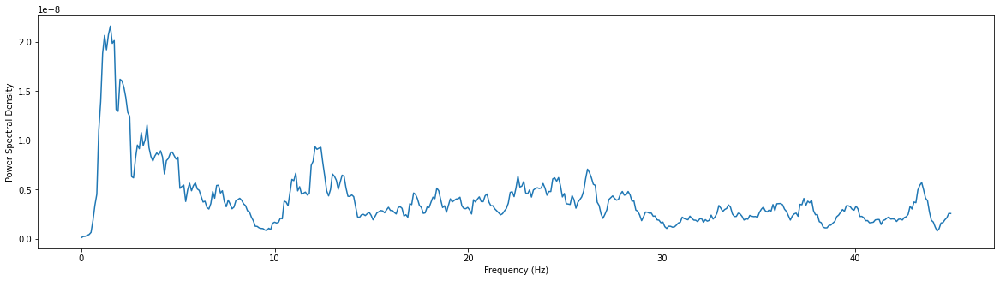

In [32]:
key_frequencies(first_selected)

# Second dataset

In [104]:
second = load_data("https://raw.githubusercontent.com/aalexren/iu-dsp/master/hw03/second.csv")
second[:3]

,0,1,2,3,4,5,6,7,8,9,...,22,23,24,25,26,27,28,29,30,31
0,5.261264e-07,0.000002,-0.000002,-0.000005,-0.000001,-1.183351e-06,0.000001,-0.000005,-0.000010,-0.000003,...,-3.943408e-06,-0.000011,-2.854930e-06,-0.000005,-0.000006,-0.000006,2.254013e-07,9.603496e-07,-0.000002,-3.486116e-06
1,-3.187151e-06,-0.000002,-0.000005,-0.000006,-0.000003,-7.912727e-07,0.000002,-0.000007,-0.000012,-0.000004,...,-2.244248e-06,-0.000028,-1.044503e-06,-0.000006,-0.000004,-0.000005,5.608630e-06,8.032282e-06,0.000003,-1.121946e-07
2,-5.041660e-06,-0.000004,-0.000007,-0.000008,-0.000005,-4.482601e-07,0.000003,-0.000009,-0.000014,-0.000005,...,-7.088315e-07,-0.000042,9.850294e-08,-0.000006,-0.000002,-0.000004,1.027538e-05,1.359412e-05,0.000006,2.565949e-06


In [105]:
second_mne = pddf_to_mne(second)
second_mne

Creating RawArray with float64 data, n_channels=32, n_times=9974
    Range : 0 ... 9973 =      0.000 ...     9.973 secs
Ready.
Applying baseline correction (mode: mean)


<RawArray | 32 x 9974 (10.0 s), ~2.5 MB, data loaded>

Effective window size : 0.256 (s)


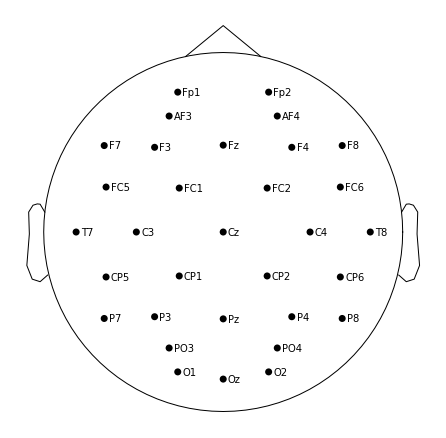

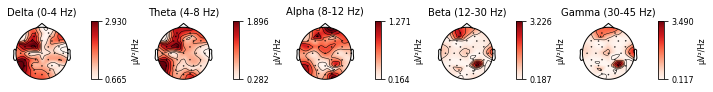

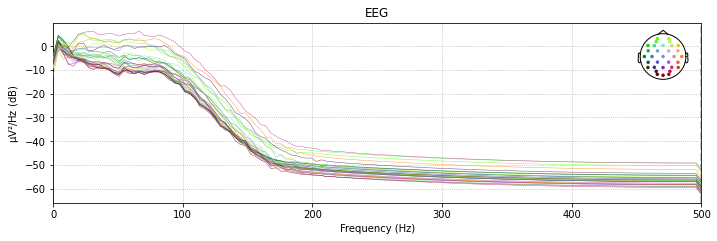

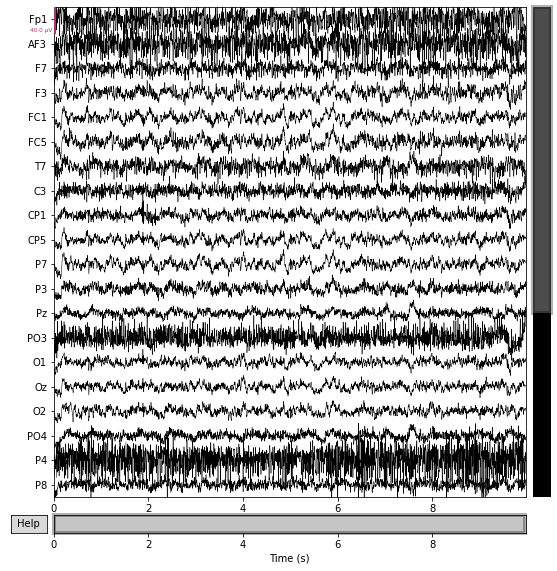

In [130]:
plot_mne(second_mne)

Effective window size : 0.256 (s)


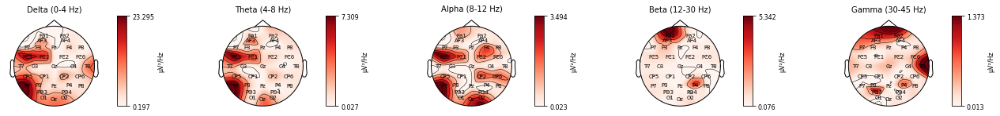

Effective window size : 0.256 (s)


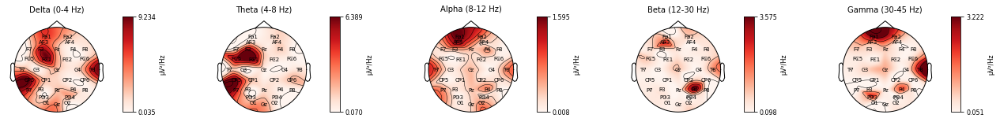

Effective window size : 0.256 (s)


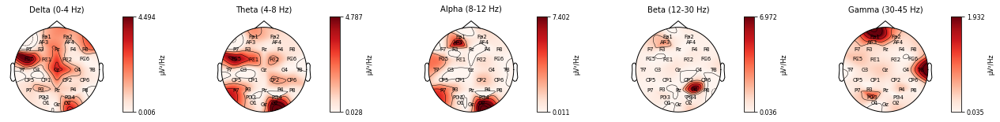

Effective window size : 0.256 (s)


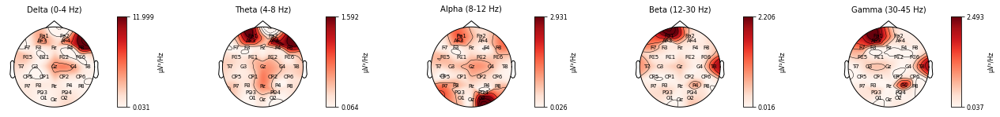

Effective window size : 0.256 (s)


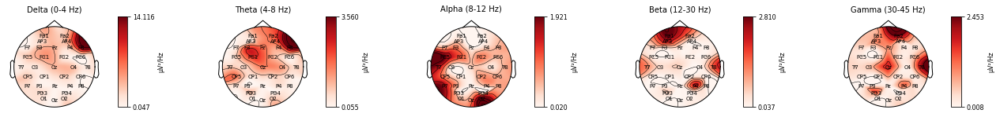

Effective window size : 0.256 (s)


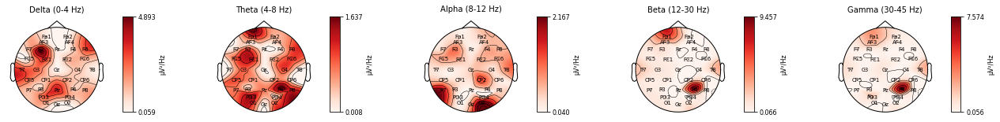

Effective window size : 0.256 (s)


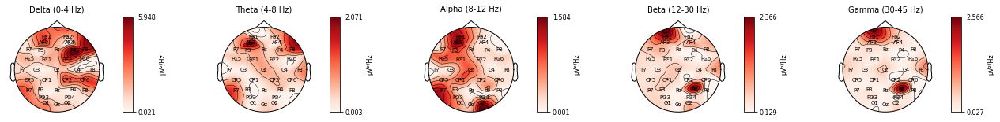

Effective window size : 0.256 (s)


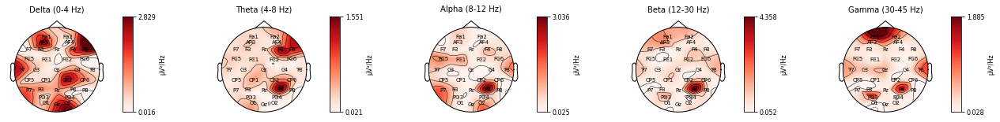

Effective window size : 0.256 (s)


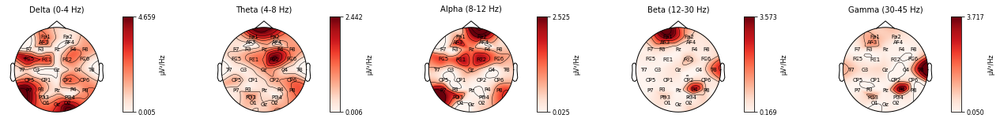

Effective window size : 0.256 (s)


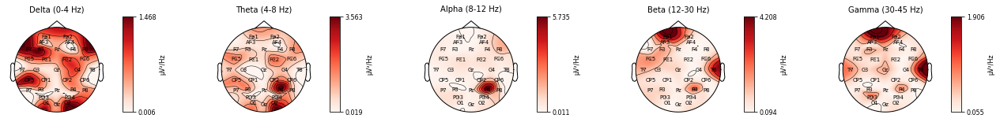

Effective window size : 0.256 (s)


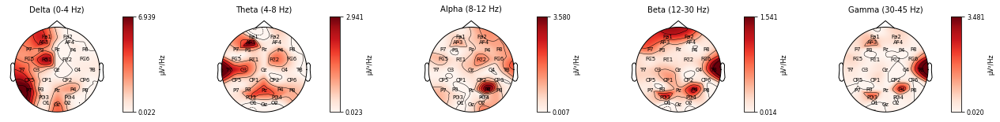

Effective window size : 0.256 (s)


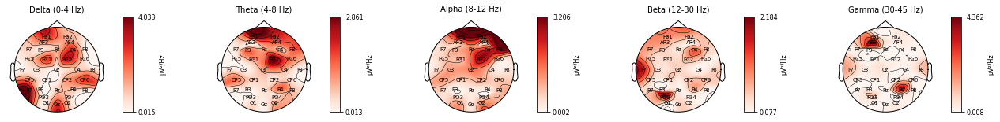

Effective window size : 0.256 (s)


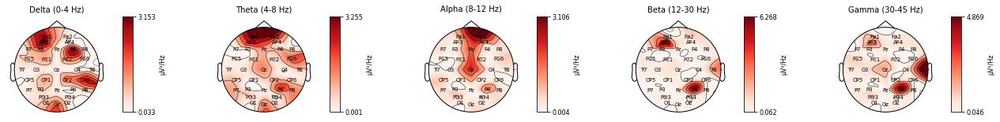

Effective window size : 0.256 (s)


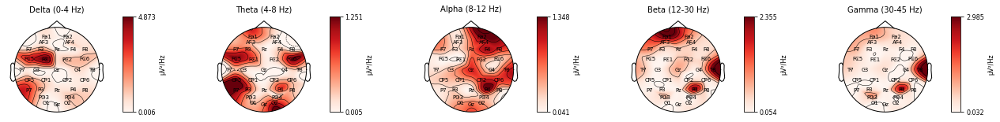

Effective window size : 0.256 (s)


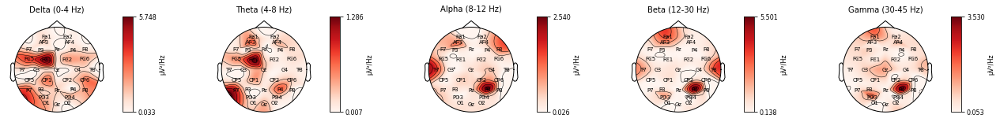

Effective window size : 0.256 (s)


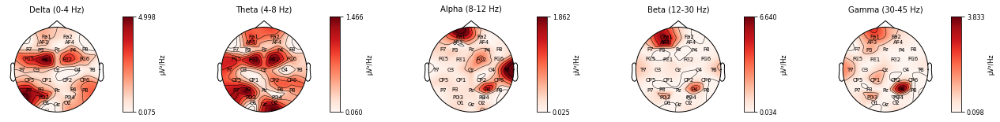

Effective window size : 0.256 (s)


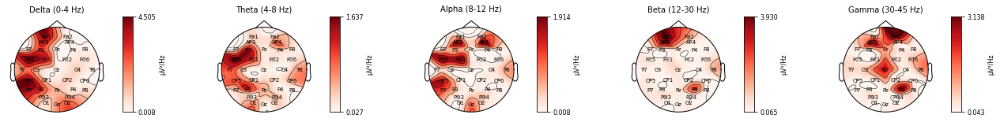

Effective window size : 0.256 (s)


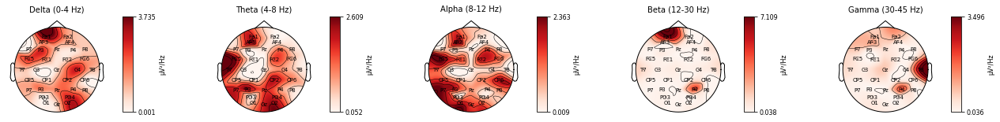

Effective window size : 0.256 (s)


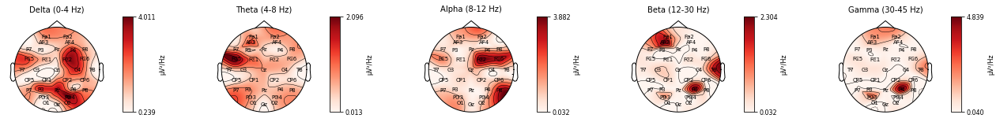

Effective window size : 0.256 (s)


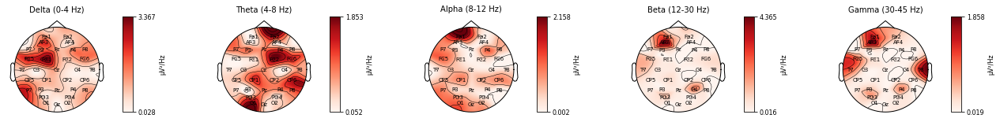

Effective window size : 0.256 (s)


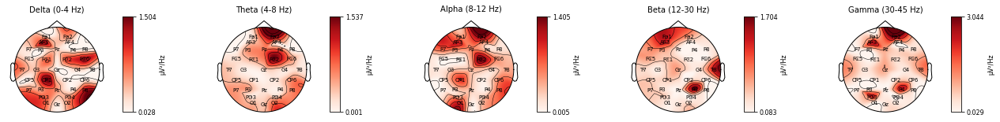

Effective window size : 0.256 (s)


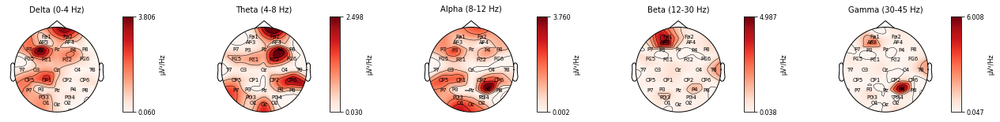

Effective window size : 0.256 (s)


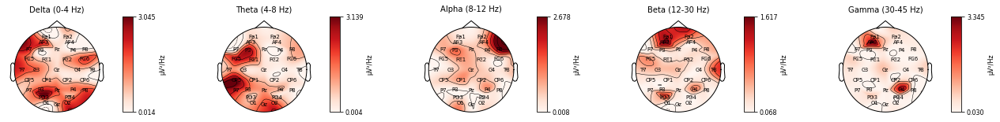

Effective window size : 0.256 (s)


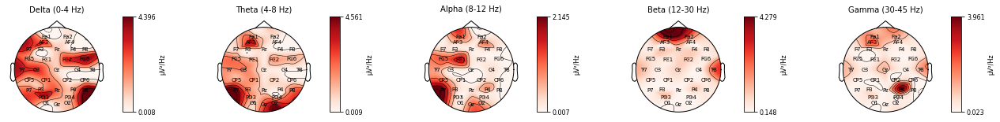

Effective window size : 0.256 (s)


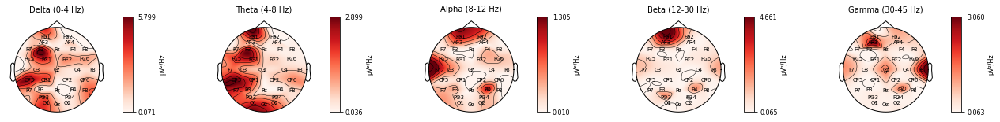

Effective window size : 0.256 (s)


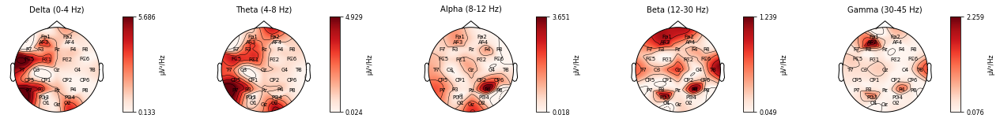

Effective window size : 0.256 (s)


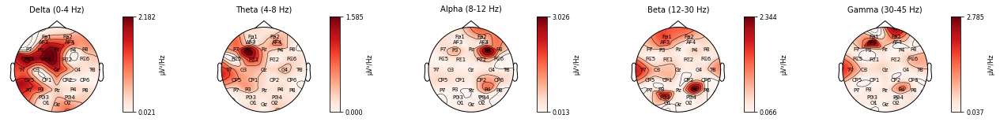

Effective window size : 0.256 (s)


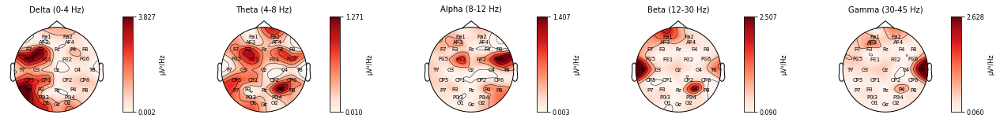

Effective window size : 0.256 (s)


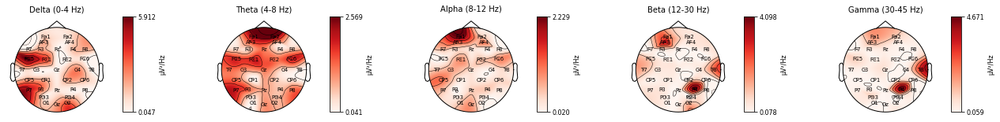

Effective window size : 0.256 (s)


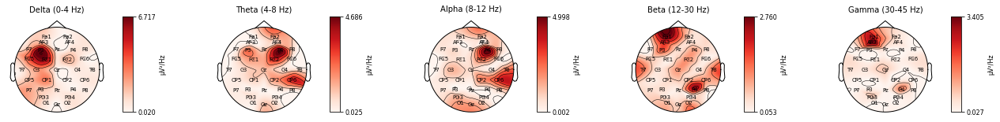

Effective window size : 0.256 (s)


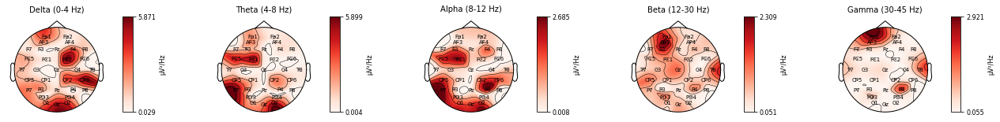

Effective window size : 0.256 (s)


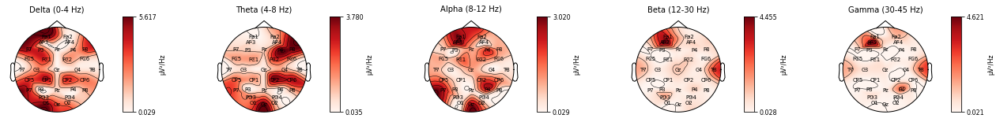

Effective window size : 0.256 (s)


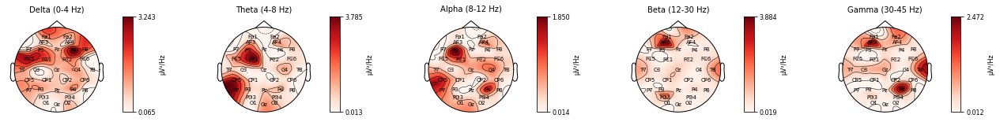

Effective window size : 0.256 (s)


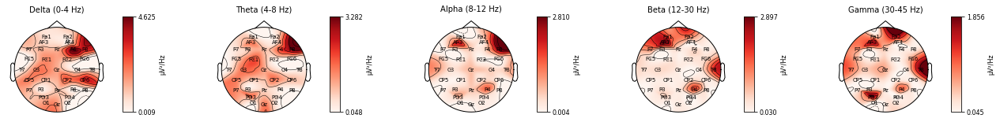

Effective window size : 0.256 (s)


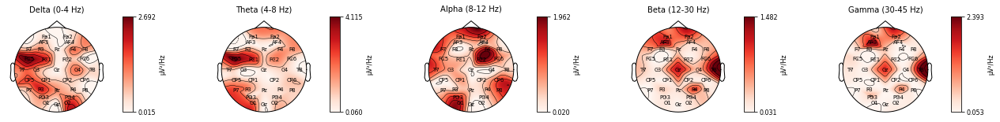

Effective window size : 0.256 (s)


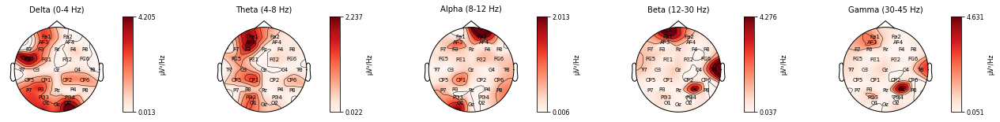

Effective window size : 0.256 (s)


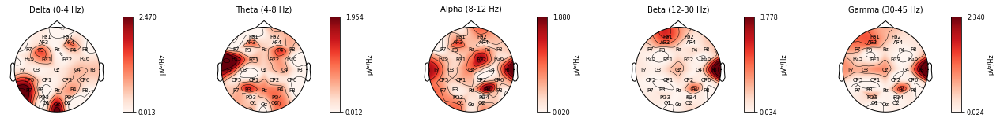

Effective window size : 0.256 (s)


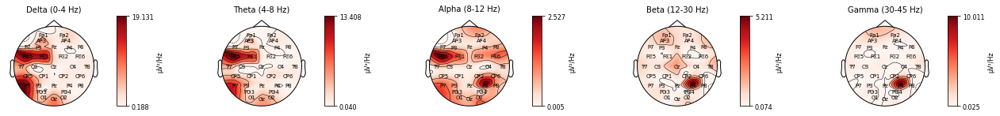

Effective window size : 0.256 (s)


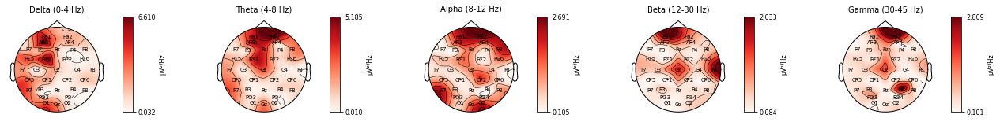

Effective window size : 0.256 (s)


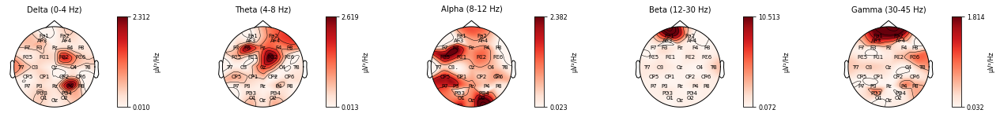

Effective window size : 0.256 (s)


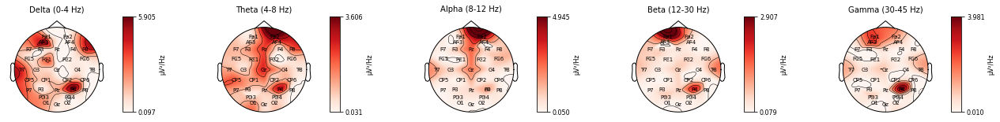

Effective window size : 0.256 (s)


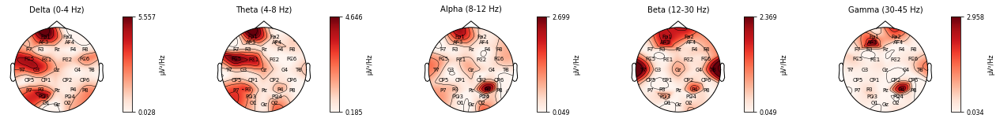

Effective window size : 0.256 (s)


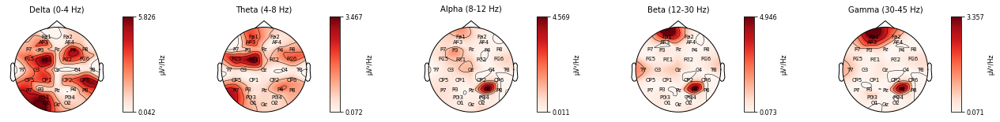

Effective window size : 0.256 (s)


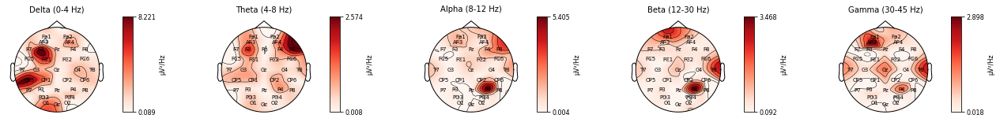

Effective window size : 0.256 (s)


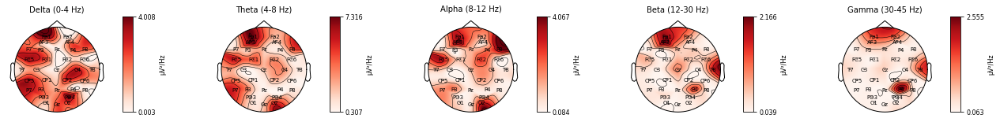

Effective window size : 0.256 (s)


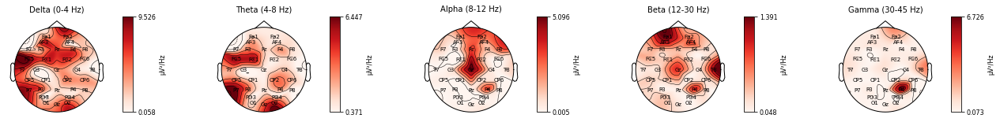

Effective window size : 0.256 (s)


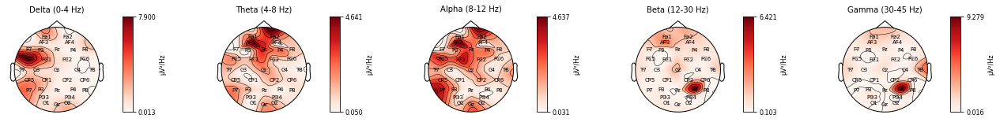

Effective window size : 0.256 (s)


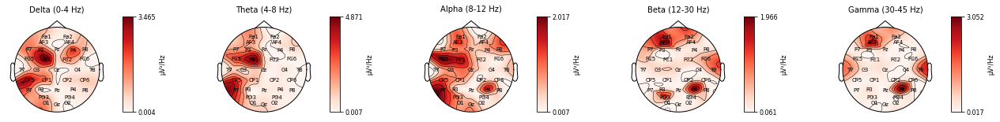

Effective window size : 0.256 (s)


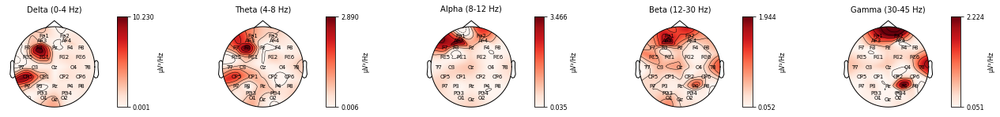

Effective window size : 0.256 (s)


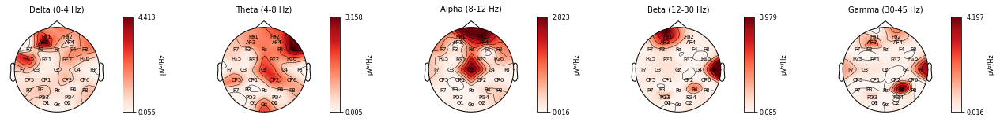

Effective window size : 0.256 (s)


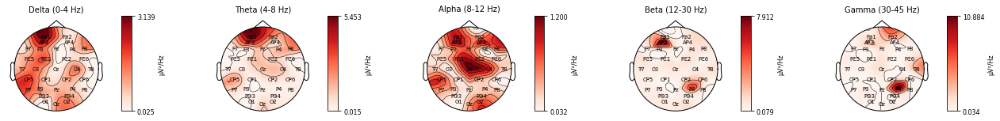

Effective window size : 0.256 (s)


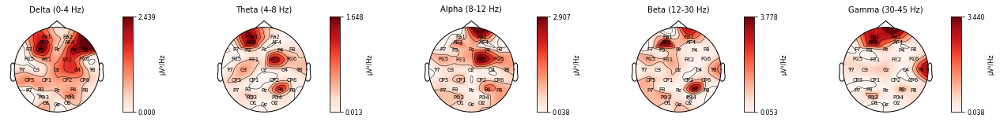

Effective window size : 0.256 (s)


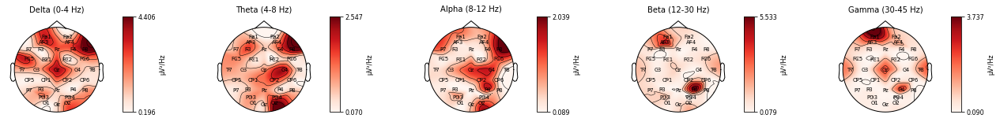

Effective window size : 0.256 (s)


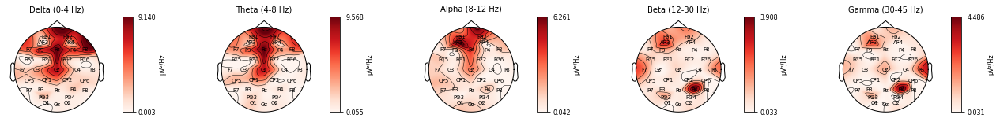

Effective window size : 0.256 (s)


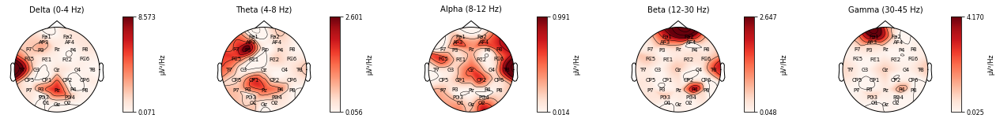

Effective window size : 0.256 (s)


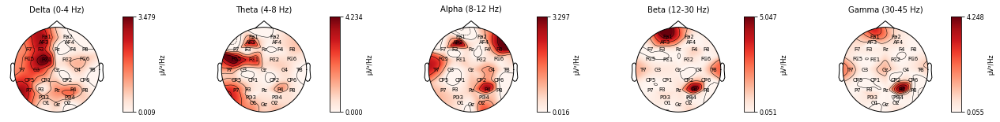

Effective window size : 0.256 (s)


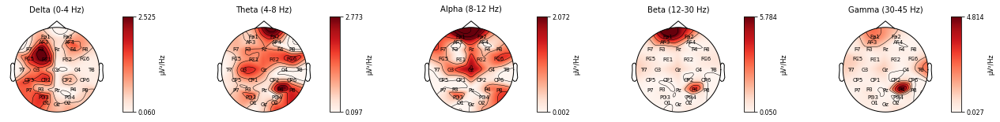

Effective window size : 0.256 (s)


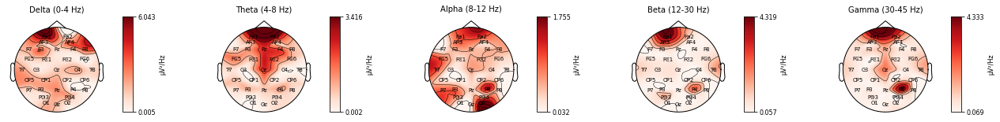

Effective window size : 0.256 (s)


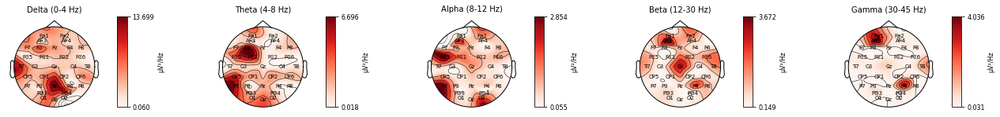

Effective window size : 0.256 (s)


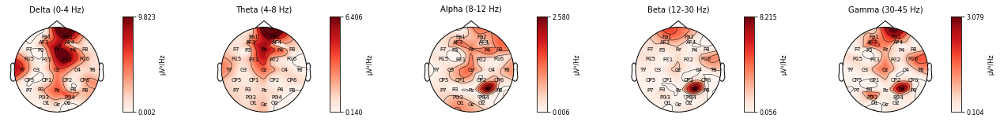

Effective window size : 0.256 (s)


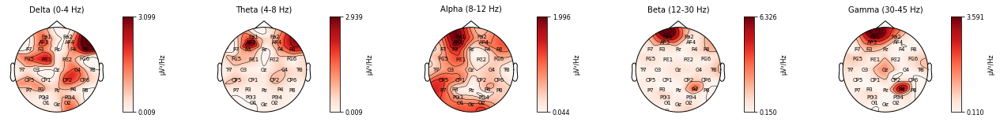

Effective window size : 0.256 (s)


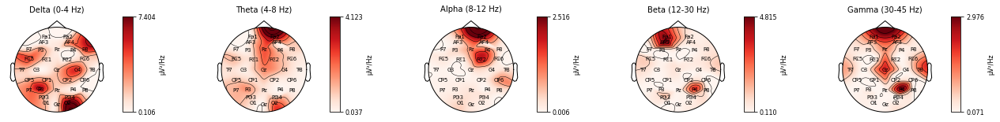

Effective window size : 0.256 (s)


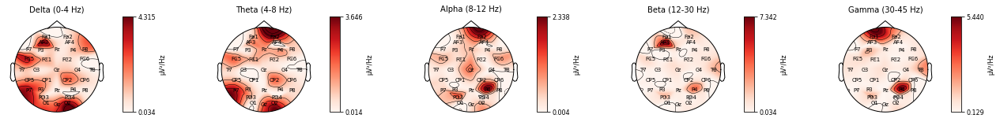

In [114]:
topomap_motion(second_mne, 0, 9., name="second.gif")

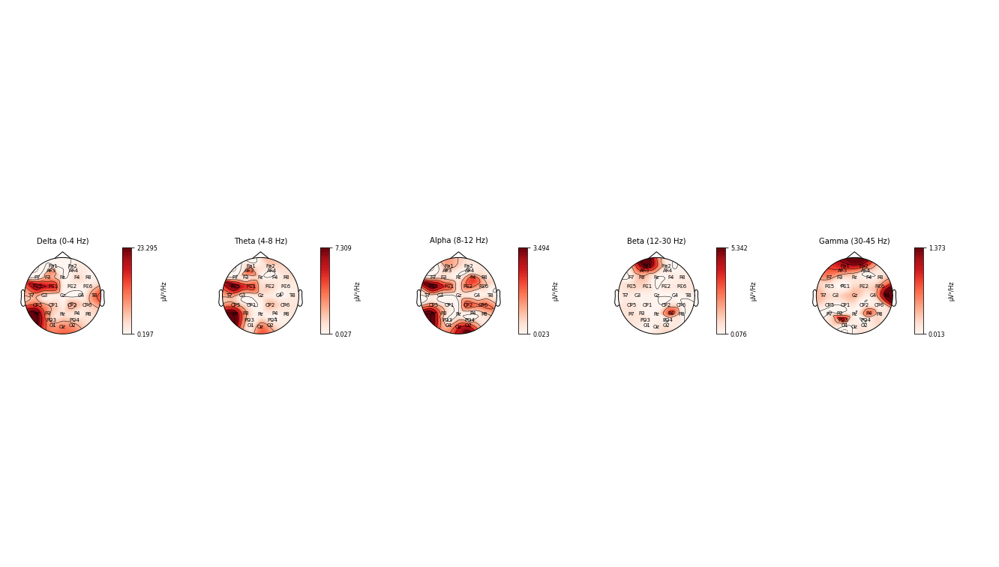

In [115]:
Image(open('second.gif','rb').read())

## Observations

### First group

    Using multitaper spectrum estimation with 7 DPSS windows


<RawArray | 3 x 10012 (10.0 s), ~257 kB, data loaded>

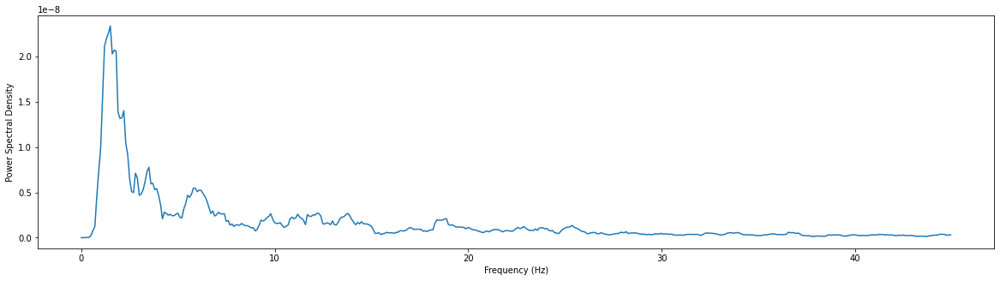

In [133]:
first_selected = extract_channels(first_mne, ["CP5", "CP1", "P7"])
key_frequencies(first_selected)
first_selected

    Using multitaper spectrum estimation with 7 DPSS windows


<RawArray | 3 x 9974 (10.0 s), ~257 kB, data loaded>

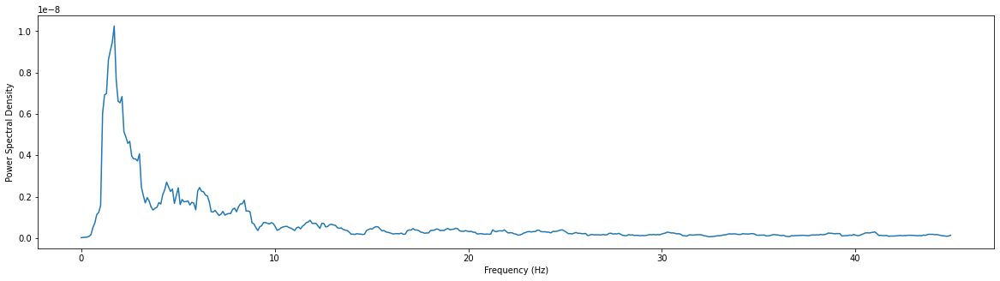

In [134]:
second_selected = extract_channels(second_mne, ["CP5", "CP1", "P7"])
key_frequencies(second_selected)
second_selected

Using a threshold of 7.708647
stat_fun(H1): min=0.000000 max=3389.992794
Running initial clustering …
Found 398 clusters


<ipython-input-135-4b10a8cc1874>:3: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  T_obs, clusters, p_values, _ = mne.stats.spatio_temporal_cluster_test(


  0%|          | Permuting : 0/999 [00:00<?,       ?it/s]

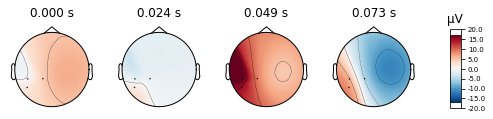

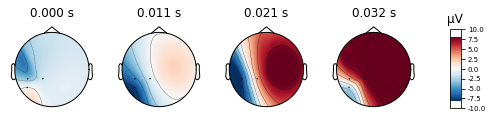

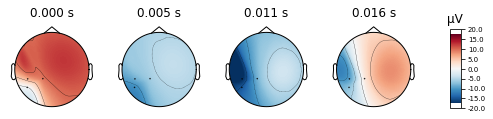

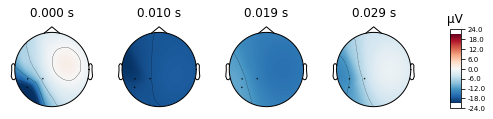

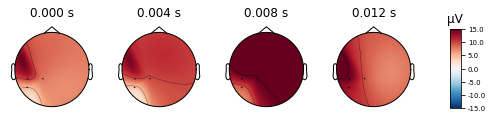

...

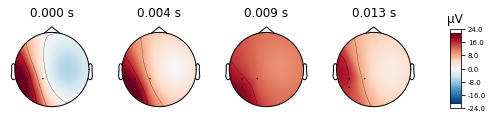

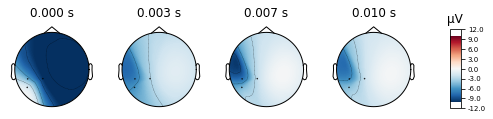

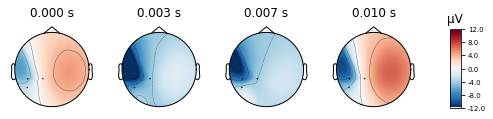

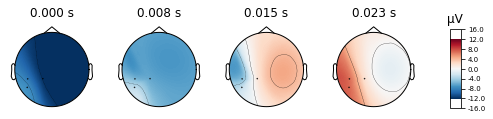

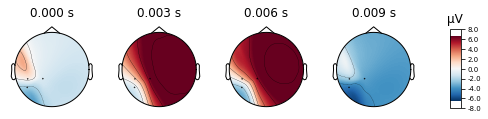

In [135]:
f, s = first_selected.copy().crop(tmax=9.), second_selected.copy().crop(tmax=9.)

T_obs, clusters, p_values, _ = mne.stats.spatio_temporal_cluster_test(
    [f.get_data(), s.get_data()], n_permutations=1000)
good_cluster_inds = np.where(p_values < 0.5)[0]

for i_clu, clu_idx in enumerate(good_cluster_inds):
    time_inds = clusters[clu_idx]
    evoked_cluster = mne.EvokedArray(
        np.mean(f.get_data()[:, time_inds], axis=1), f.info)
    evoked_cluster.plot_topomap()

### Second group

    Using multitaper spectrum estimation with 7 DPSS windows


<RawArray | 3 x 10012 (10.0 s), ~257 kB, data loaded>

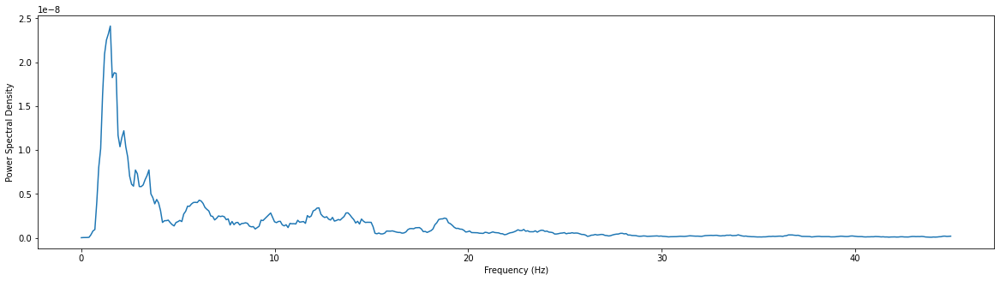

In [136]:
first_selected = extract_channels(first_mne, ["O1", "Oz", "O2"])
key_frequencies(first_selected)
first_selected

    Using multitaper spectrum estimation with 7 DPSS windows


<RawArray | 3 x 9974 (10.0 s), ~257 kB, data loaded>

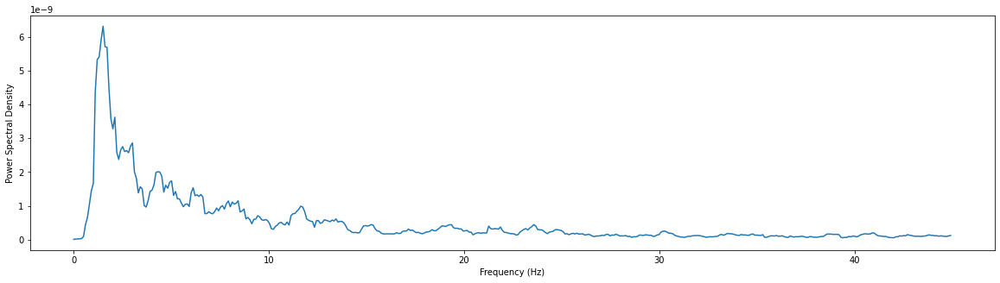

In [137]:
second_selected = extract_channels(second_mne, ["O1", "Oz", "O2"])
key_frequencies(second_selected)
second_selected

Using a threshold of 7.708647
stat_fun(H1): min=0.000000 max=1489.214657
Running initial clustering …
Found 359 clusters


<ipython-input-138-4b10a8cc1874>:3: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  T_obs, clusters, p_values, _ = mne.stats.spatio_temporal_cluster_test(


  0%|          | Permuting : 0/999 [00:00<?,       ?it/s]

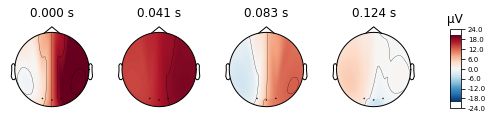

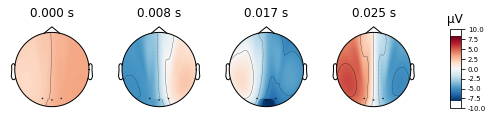

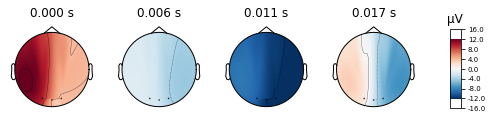

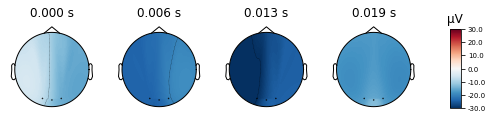

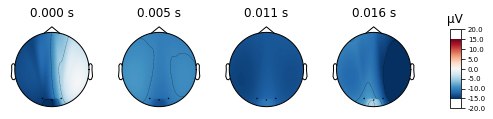

...

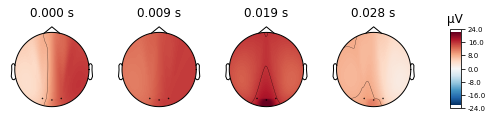

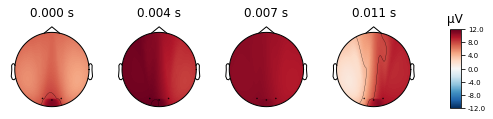

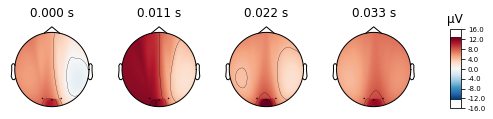

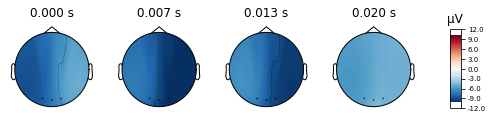

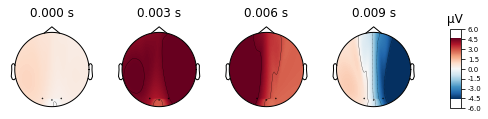

In [138]:
f, s = first_selected.copy().crop(tmax=9.), second_selected.copy().crop(tmax=9.)

T_obs, clusters, p_values, _ = mne.stats.spatio_temporal_cluster_test(
    [f.get_data(), s.get_data()], n_permutations=1000)
good_cluster_inds = np.where(p_values < 0.5)[0]

for i_clu, clu_idx in enumerate(good_cluster_inds):
    time_inds = clusters[clu_idx]
    evoked_cluster = mne.EvokedArray(
        np.mean(f.get_data()[:, time_inds], axis=1), f.info)
    evoked_cluster.plot_topomap()

Seems like the main activity for both groups are the **theta** and **delta** frequency ranges.

First group of channels CP1, CP5, P7 are belonging to **Parietal Lobe**. Second group of O1, O2, Oz are belonging to **Occipital Lobe**. Both of them applicable for first and second dataset, hence we just need to compare how much they differ between each other using statistic.

![image.png](https://www.dana.org/wp-content/uploads/2019/08/anatomy-function-brain-areas-basics-aug-2019-2024.jpg)